In [1]:
import xgboost as xgb
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, KFold, cross_val_score, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score 

In [2]:
# Load the data into a DataFrame
df = pd.read_csv('MLdf.csv')
df

,date,siteid,nitrate_mean,specific_conductance,DO,pH,chlorophyll,turbidity,fDOM,mean_temp,...,ln_nitrate_mean,ln_specific_conductance,ln_DO,ln_chlorophyll,ln_turbidity,ln_fDOM,ln_CH4_conc,ln_CO2_conc,ln_N2O_conc,ln_Microbialabundanceper_ml
0,2018-01-01,ARIK,13.700000,539.059444,10.186389,7.822500,2.095000,2.899444,45.220000,2.302481,...,2.617396,6.289826,2.321052,0.739554,1.064519,3.811539,3.250097,7.391244,-0.710933,10.871886
1,2018-01-02,ARIK,13.700000,539.059444,10.186389,7.822500,2.095000,2.899444,45.220000,2.302481,...,2.617396,6.289826,2.321052,0.739554,1.064519,3.811539,3.250097,7.391244,-0.710933,10.871886
2,2018-01-03,ARIK,13.700000,539.059444,10.186389,7.822500,2.095000,2.899444,45.220000,2.302481,...,2.617396,6.289826,2.321052,0.739554,1.064519,3.811539,3.250097,7.391244,-0.710933,10.871886
3,2018-01-04,ARIK,12.535417,546.480042,9.921785,7.812403,3.249465,60.369840,45.220000,2.302481,...,2.528558,6.303498,2.294733,1.178490,4.100490,3.811539,3.250097,7.391244,-0.710933,10.871886
4,2018-01-05,ARIK,10.310417,550.830208,9.721729,7.826743,5.565236,2.548007,45.220000,2.302481,...,2.333155,6.311427,2.274364,1.716539,0.935311,3.811539,3.250097,7.391244,-0.710933,10.871886
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23441,2020-12-27,WLOU,0.001000,298.291892,11.899740,8.146028,0.220042,0.959097,16.215236,17.389786,...,-6.907755,5.698073,2.476517,-1.513938,-0.041763,2.785951,1.032457,6.691841,-0.320212,10.901399
23442,2020-12-28,WLOU,0.041758,12.105146,8.384253,6.651626,0.900684,2.639976,31.655028,10.173146,...,-3.175858,2.493631,2.126355,-0.104601,0.970770,3.454897,1.032457,6.691841,-0.320212,10.901399
23443,2020-12-29,WLOU,4.188542,613.853512,10.900608,7.869108,9.817500,0.600420,4.082917,4.325874,...,1.432353,6.419756,2.388819,2.284167,-0.510126,1.406812,1.032457,6.691841,-0.320212,10.901399
23444,2020-12-30,WLOU,54.432292,176.735399,14.561951,7.948806,1.642281,2.160620,142.774583,3.839376,...,3.996958,5.174654,2.678412,0.496086,0.770395,4.961267,1.032457,6.691841,-0.320212,10.901399


In [3]:
# Define the features (X) and label the target (y)

#data split for level-level
X = df.drop(['date','siteid','Microbialabundanceper_ml', 'ln_nitrate_mean', 'ln_specific_conductance', 'ln_DO', 'ln_chlorophyll', 
             'ln_turbidity', 'ln_fDOM', 'ln_CH4_conc', 'ln_CO2_conc', 'ln_N2O_conc', 'ln_Microbialabundanceper_ml'], axis=1)
y = df['Microbialabundanceper_ml']

#data split for log-level
X2 = df.drop(['date','siteid','Microbialabundanceper_ml', 'ln_nitrate_mean', 'ln_specific_conductance', 'ln_DO', 'ln_chlorophyll', 
             'ln_turbidity', 'ln_fDOM', 'ln_CH4_conc', 'ln_CO2_conc', 'ln_N2O_conc', 'ln_Microbialabundanceper_ml'], axis=1)
y2 = df['ln_Microbialabundanceper_ml']

#data split for log-log
X3 = df.drop(['date','siteid','Microbialabundanceper_ml', 'nitrate_mean', 'specific_conductance', 'DO', 'chlorophyll', 
             'turbidity', 'fDOM', 'CH4_conc', 'CO2_conc', 'N2O_conc', 'ln_Microbialabundanceper_ml'], axis=1)
y3 = df['ln_Microbialabundanceper_ml']

In [4]:
#train and test split, 80:20, for model training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size = 0.2, random_state = 42)

X_train3, X_test3, y_train3, y_test3 = train_test_split(X3, y3, test_size = 0.2, random_state = 42)

In [5]:
#check the shape for each train-test split
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

print(X_train2.shape)
print(X_test2.shape)
print(y_train2.shape)
print(y_test2.shape)

print(X_train3.shape)
print(X_test3.shape)
print(y_train3.shape)
print(y_test3.shape)

(18756, 11)
(4690, 11)
(18756,)
(4690,)
(18756, 11)
(4690, 11)
(18756,)
(4690,)
(18756, 11)
(4690, 11)
(18756,)
(4690,)


## First build level-level XGBoost model

In [6]:
# Define the parameter grid
param_grid={'booster':['gbtree'],
            'tree_method':['gpu_hist'],
            'objective': ['reg:squarederror'],
            'eval_metric':['rmse'],
            'predictor':['gpu_predictor'],
            'sampling_method':['gradient_based'],
            'learning_rate': [0.001, 0.01, 0.1, 0.3, 0.4],
            'gamma': np.linspace(0, 1, 5),
            'max_depth':(6, 8, 10),
            'grow_policy':['lossguide'],
            'subsample':[0.5],
            'min_child_weight':[1,2,3],
            'random_state': [42]
    }



# Instantiate the XGBoost model
model = xgb.XGBRegressor()

# Create the GridSearchCV object with k=5 for k-fold cv
grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1, scoring='r2')

# Fit the GridSearchCV object to the data
grid_search.fit(X_train, y_train)

# Print the best parameters and the best score
print("Best parameters: {}".format(grid_search.best_params_))
print("Best score: {:.2f}".format(grid_search.best_score_))


Best parameters: {'booster': 'gbtree', 'eval_metric': 'rmse', 'gamma': 0.0, 'grow_policy': 'lossguide', 'learning_rate': 0.1, 'max_depth': 10, 'min_child_weight': 1, 'objective': 'reg:squarederror', 'predictor': 'gpu_predictor', 'random_state': 42, 'sampling_method': 'gradient_based', 'subsample': 0.5, 'tree_method': 'gpu_hist'}
Best score: 0.85


In [7]:
# Extract the best parameters from the GridSearchCV object
best_params = grid_search.best_params_

# Initialize a new XGBoost regressor model with the best parameters
xgbmod = xgb.XGBRegressor(**best_params)

# Train the model on your training data
xgbmod.fit(X_train, y_train)

# Use the trained model to make predictions on your test data
y_pred = xgbmod.predict(X_test)
print(y_pred)

[ 480928.94  1270272.     383937.53  ... 3767472.2     35596.848
 3029391.5  ]


In [8]:
# Calculate the mean squared error of the predictions
mse = mean_squared_error(y_test, y_pred)

# Calculate the root mean squared error of the predictions
rmse = mean_squared_error(y_test, y_pred, squared=False)

# Calculate the mean absolute error of the predictions
mae = mean_absolute_error(y_test, y_pred)

# Calculate the R-squared value of the predictions
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error:", mse)
print("Root Mean Squared Error:", rmse)
print("Mean Absolute Error", mae)
print("R-squared:", r2)

Mean Squared Error: 8080462071813.323
Root Mean Squared Error: 2842615.3576967325
Mean Absolute Error 847410.447285564
R-squared: 0.8386279475287787


<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

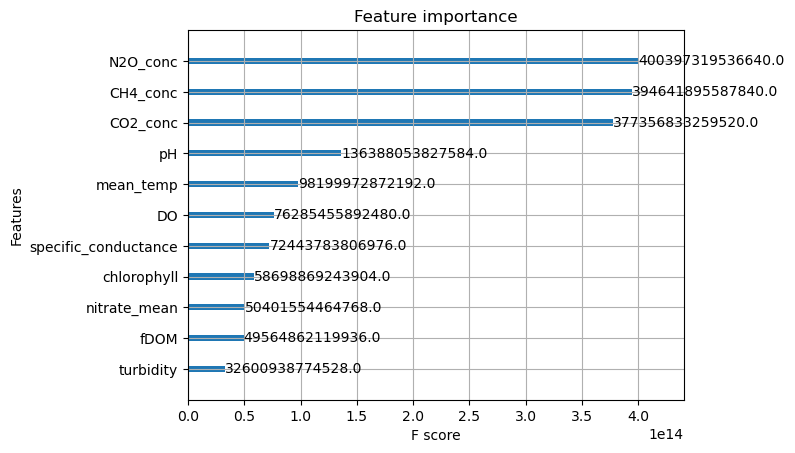

In [9]:
# XGBoost native feature importance plot for level-level model
xgb.plot_importance(xgbmod, importance_type='gain')

## Build log-level XGBoost model

In [10]:
# Define the parameter grid
param_grid2={'booster':['gbtree'],
            'tree_method':['gpu_hist'],
            'objective': ['reg:squarederror'],
            'eval_metric':['rmse'],
            'predictor':['gpu_predictor'],
            'sampling_method':['gradient_based'],
            'learning_rate': [0.001, 0.01, 0.1, 0.3, 0.4],
            'gamma': np.linspace(0, 1, 5),
            'max_depth':(6, 8, 10),
            'grow_policy':['lossguide'],
            'subsample':[0.5],
            'min_child_weight':[1,2,3],
            'random_state': [42]
    }



# Instantiate the XGBoost model
model2 = xgb.XGBRegressor()

# Create the GridSearchCV object with k=5 for k-fold cv
grid_search2 = GridSearchCV(model2, param_grid2, cv=5, n_jobs=-1, scoring='r2')

# Fit the GridSearchCV object to the data
grid_search2.fit(X_train2, y_train2)

# Print the best parameters and the best score
print("Best parameters: {}".format(grid_search2.best_params_))
print("Best score: {:.2f}".format(grid_search2.best_score_))


Best parameters: {'booster': 'gbtree', 'eval_metric': 'rmse', 'gamma': 0.25, 'grow_policy': 'lossguide', 'learning_rate': 0.1, 'max_depth': 10, 'min_child_weight': 3, 'objective': 'reg:squarederror', 'predictor': 'gpu_predictor', 'random_state': 42, 'sampling_method': 'gradient_based', 'subsample': 0.5, 'tree_method': 'gpu_hist'}
Best score: 0.85


In [11]:
# Extract the best parameters from the GridSearchCV object
best_params2 = grid_search2.best_params_

# Initialize a new XGBoost regressor model with the best parameters
xgbmod2 = xgb.XGBRegressor(**best_params2)

# Train the model on your training data
xgbmod2.fit(X_train2, y_train2)

# Use the trained model to make predictions on your test data
y_pred2 = xgbmod2.predict(X_test2)
print(y_pred2)

[13.280435 14.008251 11.874486 ... 15.12867  12.454242  9.874116]


In [12]:
# Calculate the mean squared error of the predictions
mse2 = mean_squared_error(y_test2, y_pred2)

# Calculate the root mean squared error of the predictions
rmse2 = mean_squared_error(y_test2, y_pred2, squared=False)

# Calculate the mean absolute error of the predictions
mae2 = mean_absolute_error(y_test2, y_pred2)

# Calculate the R-squared value of the predictions
r2_2 = r2_score(y_test2, y_pred2)

print("Mean Squared Error:", mse2)
print("Root Mean Squared Error:", rmse2)
print("Mean Absolute Error", mae2)
print("R-squared:", r2_2)

Mean Squared Error: 0.42952334970402295
Root Mean Squared Error: 0.6553803092129202
Mean Absolute Error 0.3804145629064078
R-squared: 0.8547551608821581


<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

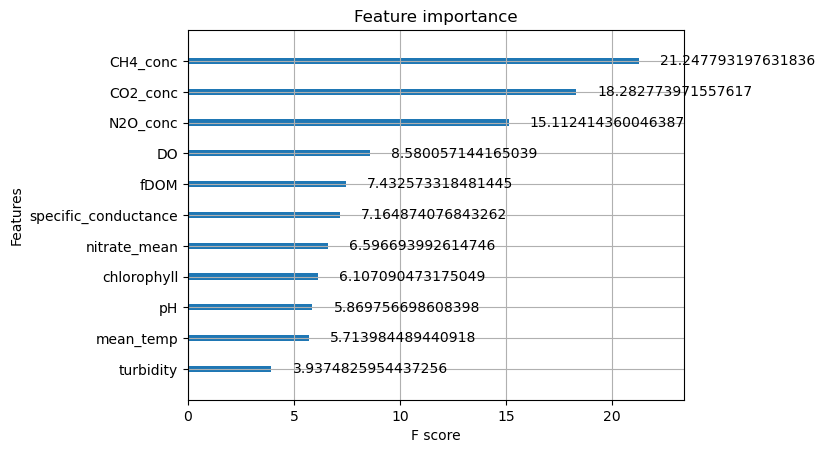

In [13]:
# XGBoost native feature importance plot for log-level model
xgb.plot_importance(xgbmod2, importance_type='gain')

## Build log-log XGBoost model

In [14]:
# Define the parameter grid
param_grid3={'booster':['gbtree'],
            'tree_method':['gpu_hist'],
            'objective': ['reg:squarederror'],
            'eval_metric':['rmse'],
            'predictor':['gpu_predictor'],
            'sampling_method':['gradient_based'],
            'learning_rate': [0.001, 0.01, 0.1, 0.3, 0.4],
            'gamma': np.linspace(0, 1, 5),
            'max_depth':(6, 8, 10),
            'grow_policy':['lossguide'],
            'subsample':[0.5],
            'min_child_weight':[1,2,3],
            'random_state': [42]
    }



# Instantiate the XGBoost model
model3 = xgb.XGBRegressor()

# Create the GridSearchCV object with k=5 for k-fold cv
grid_search3 = GridSearchCV(model3, param_grid3, cv=5, n_jobs=-1, scoring='r2')

# Fit the GridSearchCV object to the data
grid_search3.fit(X_train3, y_train3)

# Print the best parameters and the best score
print("Best parameters: {}".format(grid_search3.best_params_))
print("Best score: {:.2f}".format(grid_search3.best_score_))


Best parameters: {'booster': 'gbtree', 'eval_metric': 'rmse', 'gamma': 0.25, 'grow_policy': 'lossguide', 'learning_rate': 0.1, 'max_depth': 10, 'min_child_weight': 2, 'objective': 'reg:squarederror', 'predictor': 'gpu_predictor', 'random_state': 42, 'sampling_method': 'gradient_based', 'subsample': 0.5, 'tree_method': 'gpu_hist'}
Best score: 0.85


In [15]:
# Extract the best parameters from the GridSearchCV object
best_params3 = grid_search3.best_params_

# Initialize a new XGBoost regressor model with the best parameters
xgbmod3 = xgb.XGBRegressor(**best_params3)

# Train the model on your training data
xgbmod3.fit(X_train3, y_train3)

# Use the trained model to make predictions on your test data
y_pred3 = xgbmod3.predict(X_test3)
print(y_pred3)

[13.155499  14.0232725 11.818969  ... 14.800864  12.616757   9.883974 ]


In [16]:
# Calculate the mean squared error of the predictions
mse3 = mean_squared_error(y_test3, y_pred3)

# Calculate the root mean squared error of the predictions
rmse3 = mean_squared_error(y_test3, y_pred3, squared=False)

# Calculate the mean absolute error of the predictions
mae3 = mean_absolute_error(y_test3, y_pred3)

# Calculate the R-squared value of the predictions
r2_3 = r2_score(y_test3, y_pred3)

print("Mean Squared Error:", mse3)
print("Root Mean Squared Error:", rmse3)
print("Mean Absolute Error", mae3)
print("R-squared:", r2_3)

Mean Squared Error: 0.4448544080929559
Root Mean Squared Error: 0.6669740685311205
Mean Absolute Error 0.38992279150227427
R-squared: 0.8495709092908506


<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

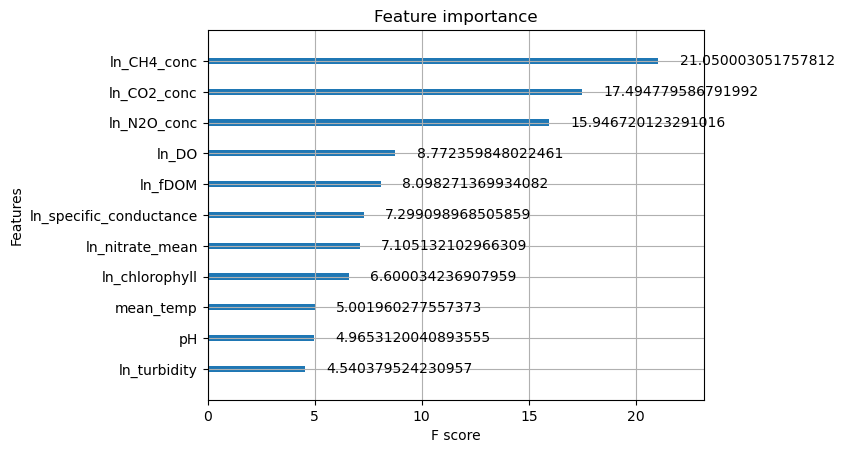

In [17]:
# XGBoost native feature importance plot for log-log model
xgb.plot_importance(xgbmod3, importance_type='gain')

In [18]:
import shap
import matplotlib.pylab as pl
import graphviz
shap.initjs()

## Illustrate SHAP interpretability method using the log-log XGBoost model
-Fit the entire log-log dataset (train + test) to create the final model for SHAP analysis. The feature interactions displayed by SHAP will give insight for future unseen samples. 

In [19]:
# Fit the log-log XGBoost model to Train the model on enitre dataset for Shap
xgbmod3.fit(X3, y3)

# Use the trained model to make in-sample predictions 
yshap = xgbmod3.predict(X3)
print(yshap)

[11.168746 11.168746 11.168746 ... 10.980841 11.244575 10.920056]


In [20]:
#In-sample error metrics 
is_mse = mean_squared_error(y3, yshap)
is_rmse = mean_squared_error(y3, yshap, squared=False)
is_mae = mean_absolute_error(y3, yshap)
is_r2 = r2_score(y3, yshap)

print("In-Sample Mean Squared Error:", is_mse)
print("In-Sample Root Mean Squared Error:", is_rmse)
print("In-Sample Mean Absolute Error", is_mae)
print("In-Sample R-squared:", is_r2)

In-Sample Mean Squared Error: 0.10862332638830254
In-Sample Root Mean Squared Error: 0.3295805309606478
In-Sample Mean Absolute Error 0.2104418666672607
In-Sample R-squared: 0.9618207927367174


In [21]:
#instantiate the tree explainer, explainer, and explainer.shap_values
explainer = shap.TreeExplainer(xgbmod3)
shap_values = explainer(X3)
shap_values2 = explainer.shap_values(X3)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


In [22]:
#array of shap values base values, note that the base prediction is 12.957189
shap_values.base_values

array([12.957189, 12.957189, 12.957189, ..., 12.957189, 12.957189,
       12.957189], dtype=float32)

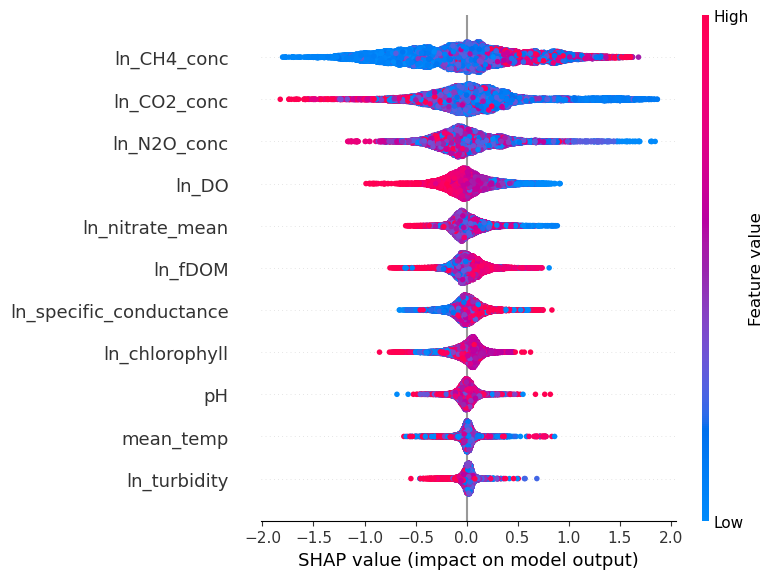

In [23]:
#shap summary plot with range of values per feature
shap.summary_plot(shap_values)

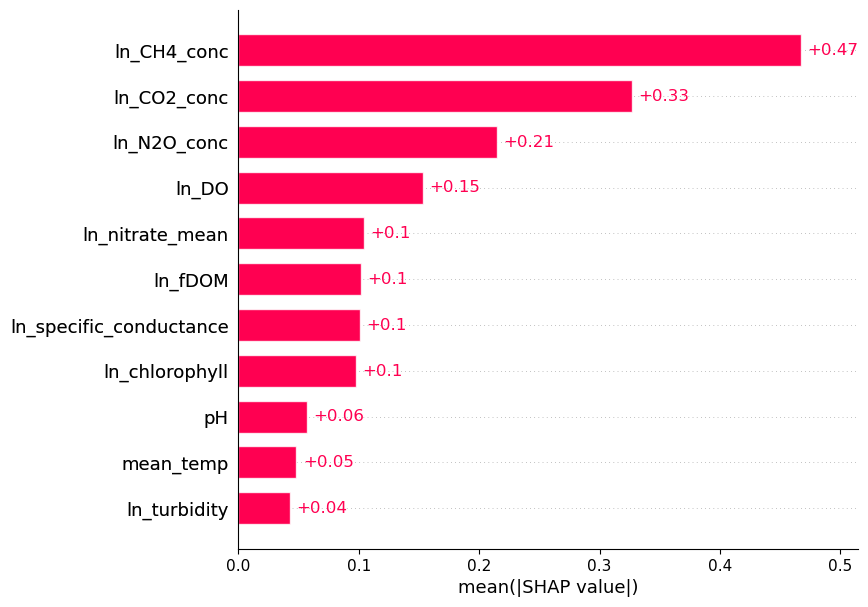

In [24]:
#shap bar plot with mean shap values 
shap.plots.bar(shap_values, max_display=11)

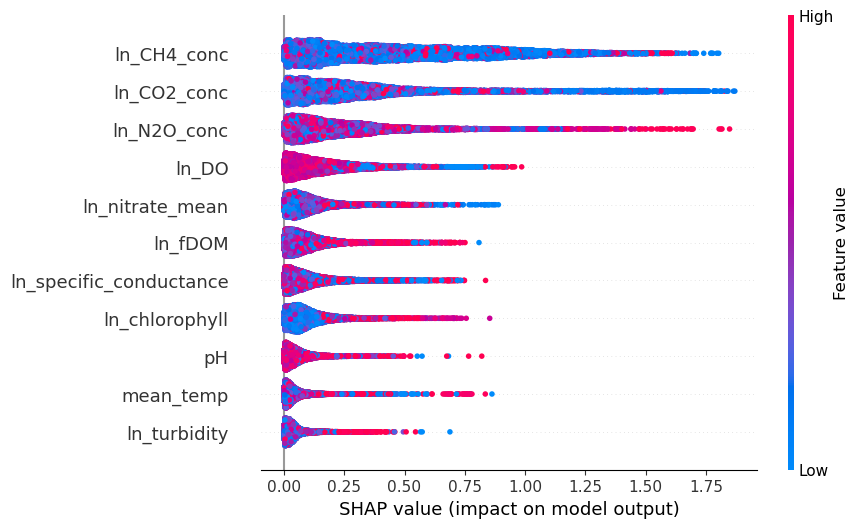

In [25]:
#shap beeswarm plot with absolute shap values and its impact on the model's output
shap.plots.beeswarm(shap_values.abs, max_display=11)

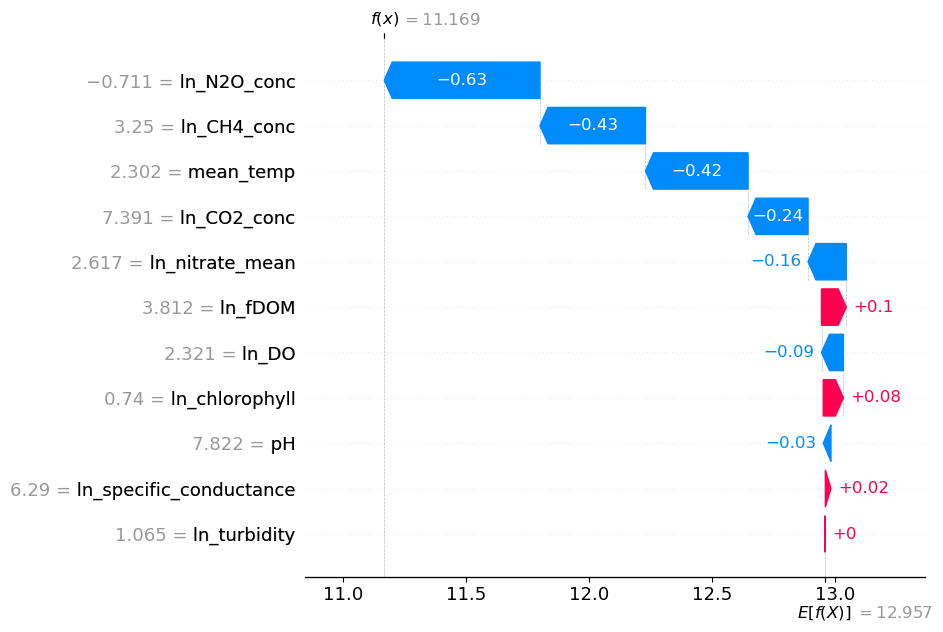

In [26]:
#shap waterfall plot displaying the feature interactions to generate the prediction for the first row in the data
shap.plots.waterfall(shap_values[0], max_display=11)

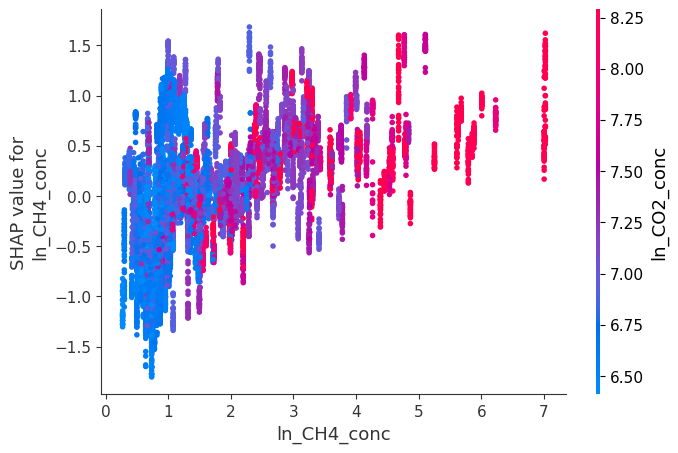

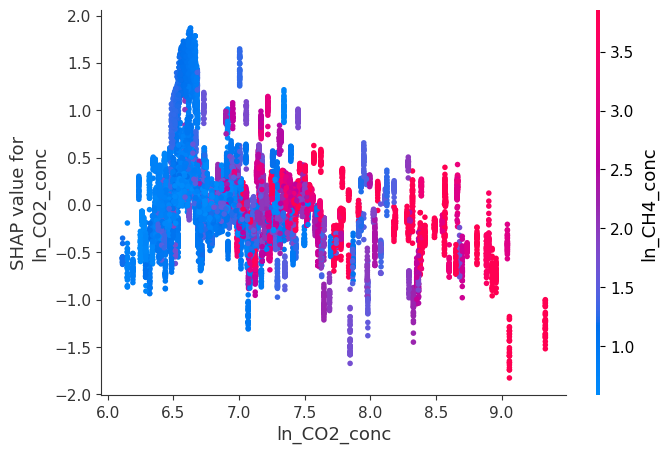

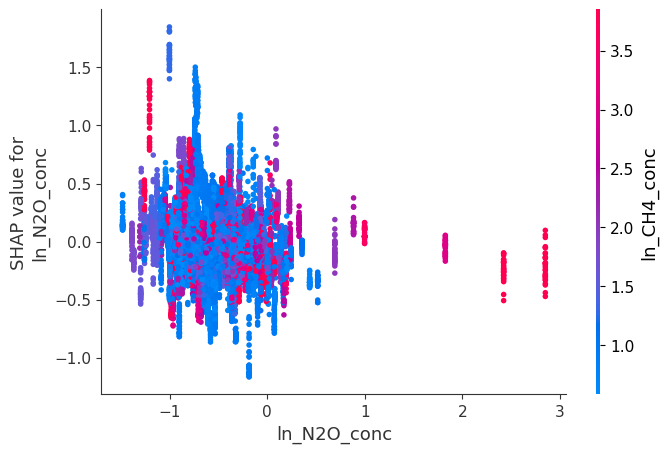

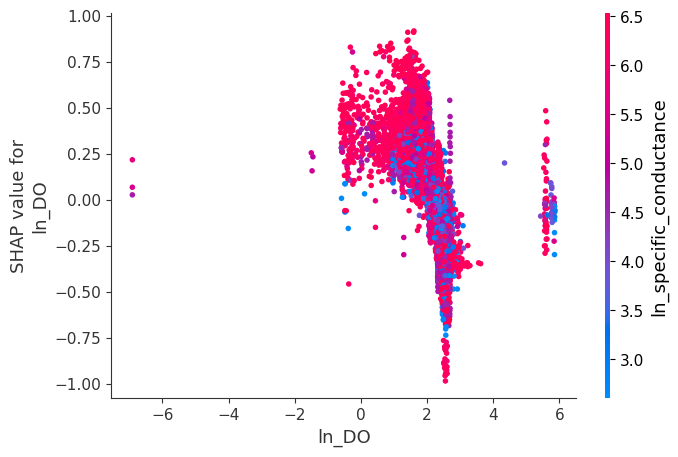

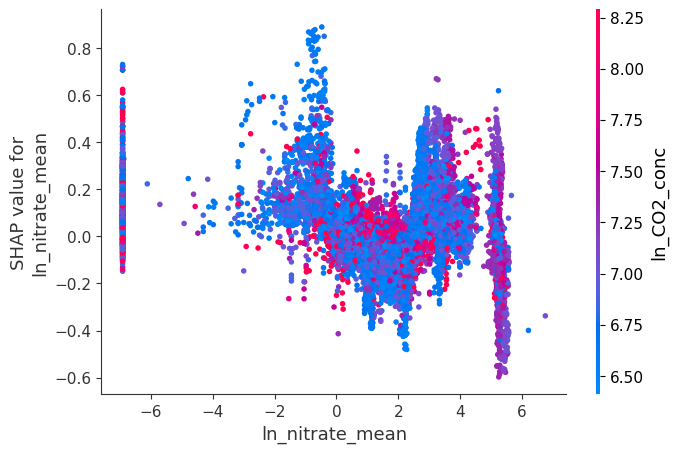

...

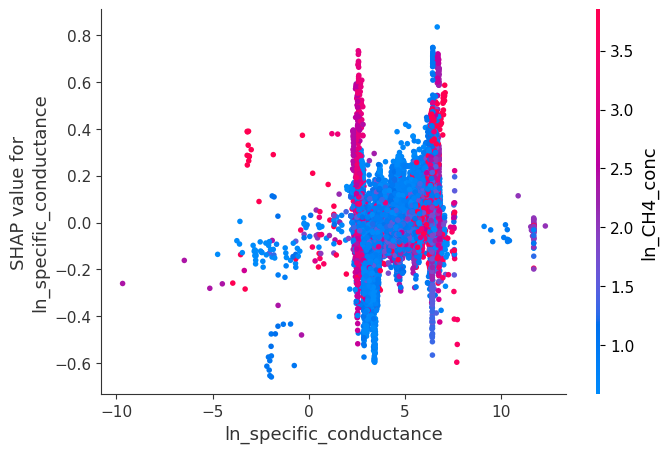

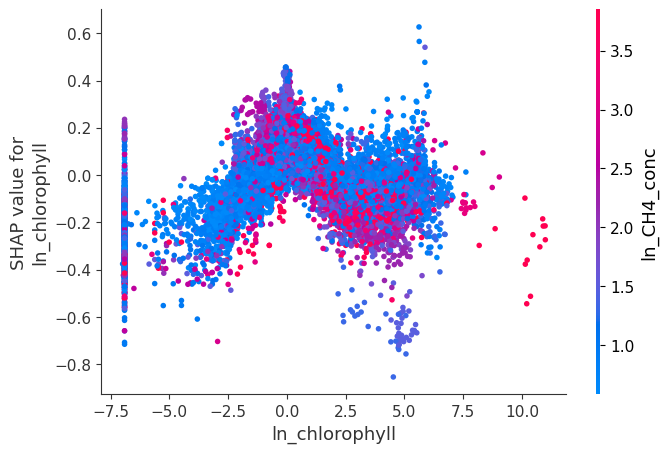

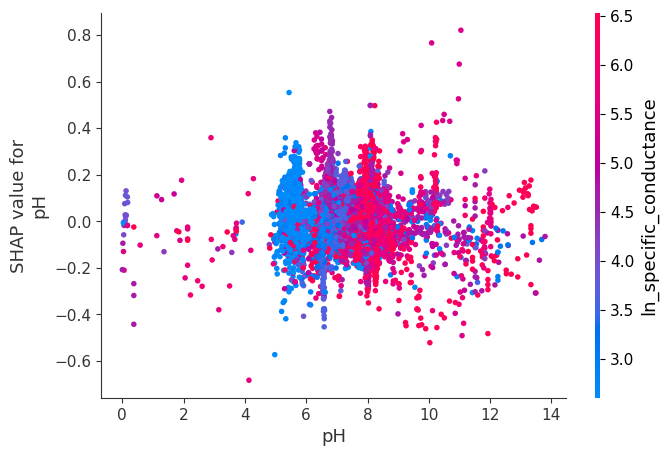

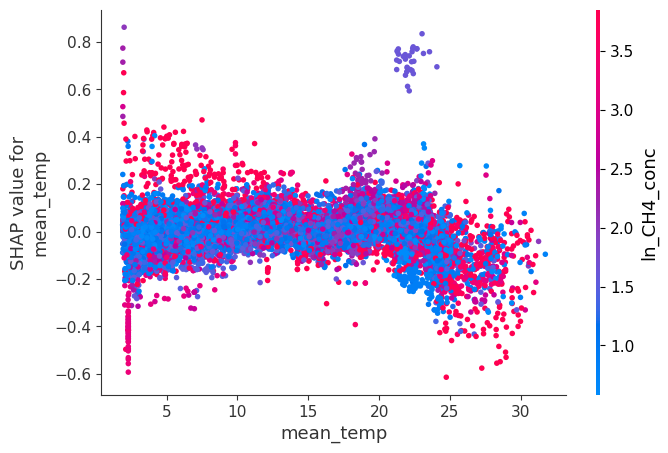

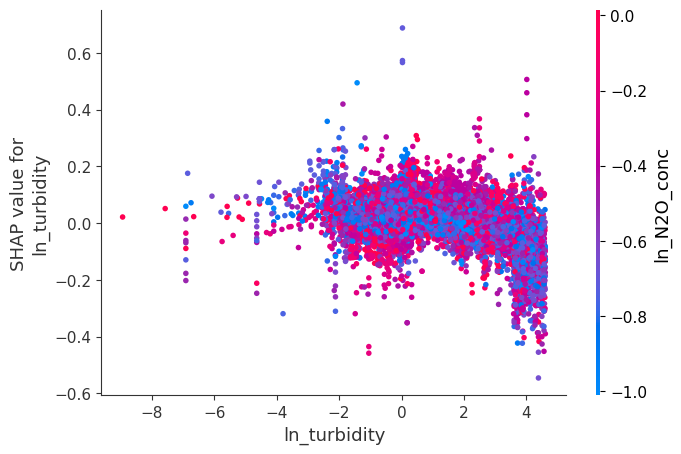

In [27]:
top_inds = np.argsort(-np.sum(np.abs(shap_values2), 0))

#Generate SHAP dependence plots for each feature
for i in range(11):
    shap.dependence_plot(top_inds[i], shap_values2, X3)

## SHAP Force plots by Siteid
- Shows the variability in feature interactions and their contribution to the output predictions by site

- The shap force plot for each siteid can be thought of as all the waterfall plots for that site stiched into one graph

In [28]:
#Siteid = ARIK
shap.force_plot(explainer.expected_value, shap_values2[0:1096,], X.iloc[0:1096,], plot_cmap="DrDb")

In [29]:
#Siteid = BIGC
shap.force_plot(explainer.expected_value, shap_values2[1096:2062,], X.iloc[1096:2062,], plot_cmap="DrDb")

In [30]:
#Siteid = BLDE
shap.force_plot(explainer.expected_value, shap_values2[2062:2892,], X.iloc[2062:2892,], plot_cmap="DrDb")

In [31]:
#Siteid = BLUE
shap.force_plot(explainer.expected_value, shap_values2[2892:3744,], X.iloc[2892:3744,], plot_cmap="DrDb")

In [32]:
#Siteid = CARI
shap.force_plot(explainer.expected_value, shap_values2[3744:4119,], X.iloc[3744:4119,], plot_cmap="DrDb")

In [33]:
#Siteid = COMO
shap.force_plot(explainer.expected_value, shap_values2[4119:5215,], X.iloc[4119:5215,], plot_cmap="DrDb")

In [34]:
#Siteid = CUPE
shap.force_plot(explainer.expected_value, shap_values2[5215:6174,], X.iloc[5215:6174,], plot_cmap="DrDb")

In [35]:
#Siteid = GUIL
shap.force_plot(explainer.expected_value, shap_values2[6174:7120,], X.iloc[6174:7120,], plot_cmap="DrDb")

In [36]:
#Siteid = HOPB
shap.force_plot(explainer.expected_value, shap_values2[7120:8216,], X.iloc[7120:8216,], plot_cmap="DrDb")

In [37]:
#Siteid = KING
shap.force_plot(explainer.expected_value, shap_values2[8216:9312,], X.iloc[8216:9312,], plot_cmap="DrDb")

In [38]:
#Siteid = LECO
shap.force_plot(explainer.expected_value, shap_values2[9312:10408,], X.iloc[9312:10408,], plot_cmap="DrDb")

In [39]:
#Siteid = LEWI
shap.force_plot(explainer.expected_value, shap_values2[10408:11504,], X.iloc[10408:11504,], plot_cmap="DrDb")

In [40]:
#Siteid = MART
shap.force_plot(explainer.expected_value, shap_values2[11504:12571,], X.iloc[11504:12571,], plot_cmap="DrDb")

In [41]:
#Siteid = MAYF
shap.force_plot(explainer.expected_value, shap_values2[12571:13667,], X.iloc[12571:13667,], plot_cmap="DrDb")

In [42]:
#Siteid = MCDI
shap.force_plot(explainer.expected_value, shap_values2[13667:14763,], X.iloc[13667:14763,], plot_cmap="DrDb")

In [43]:
#Siteid = MCRA
shap.force_plot(explainer.expected_value, shap_values2[14763:15859,], X.iloc[14763:15859,], plot_cmap="DrDb")

In [44]:
#Siteid = OKSR
shap.force_plot(explainer.expected_value, shap_values2[15859:16251,], X.iloc[15859:16251,], plot_cmap="DrDb")

In [45]:
#Siteid = POSE
shap.force_plot(explainer.expected_value, shap_values2[16251:17347,], X.iloc[16251:17347,], plot_cmap="DrDb")

In [46]:
#Siteid = PRIN
shap.force_plot(explainer.expected_value, shap_values2[17347:18443,], X.iloc[17347:18443,], plot_cmap="DrDb")

In [47]:
#Siteid = REDB
shap.force_plot(explainer.expected_value, shap_values2[18443:19391,], X.iloc[18443:19391,], plot_cmap="DrDb")

In [48]:
#Siteid = SYCA
shap.force_plot(explainer.expected_value, shap_values2[19391:20487,], X.iloc[19391:20487,], plot_cmap="DrDb")

In [49]:
#Siteid = TECR
shap.force_plot(explainer.expected_value, shap_values2[20487:21254,], X.iloc[20487:21254,], plot_cmap="DrDb")

In [50]:
#Siteid = WALK
shap.force_plot(explainer.expected_value, shap_values2[21254:22350,], X.iloc[21254:22350,], plot_cmap="DrDb")

In [51]:
#Siteid = WLOU
shap.force_plot(explainer.expected_value, shap_values2[22350:23446,], X.iloc[22350:23446,], plot_cmap="DrDb")